In [1]:
from PIL import Image, ImageOps
from fastcore.xtras import Path
import numpy as np
import torch

from diffusers import FluxControlPipeline
from transformers import AutoImageProcessor, AutoModelForDepthEstimation

In [2]:
def image_grid(imgs, rows, cols):
    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [3]:
device = 'mps' if torch.backends.mps.is_available() else 'cuda' if torch.cuda.is_available() else 'cpu'
device

'mps'

In [4]:
path=Path('/Users/sbrewer/Documents/Datasets/FFHQ')

In [5]:
names=[o.stem for o in path.ls() if o.suffix=='.png']
img_lst=[Image.open(o) for o in path.ls() if o.suffix=='.png']
img_dpth_lst=[Image.open(path/f"depth/{o}_d.png") for o in names]
prmpt_lst= [open(path/f"prompt/{o}.txt").read() for o in names]

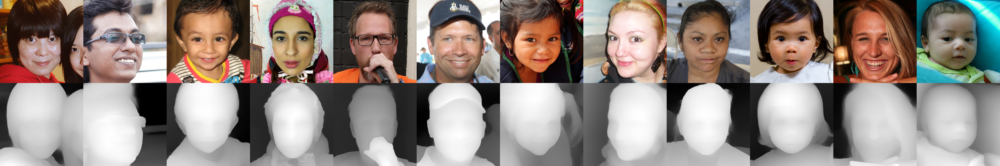

In [6]:
image_grid(img_lst+img_dpth_lst, 2,12)

In [7]:
path_mdl='/Users/sbrewer/.cache/huggingface/hub/models--black-forest-labs--FLUX.1-dev/snapshots/3de623fc3c33e44ffbe2bad470d0f45bccf2eb21'
pipe = FluxControlPipeline.from_pretrained(path_mdl, torch_dtype=torch.bfloat16).to("mps")
path_w8="/Users/sbrewer/.cache/huggingface/hub/models--black-forest-labs--FLUX.1-Depth-dev-lora/snapshots/ee9cc283d790a079d549ac0bf9ef7183082e3d90"
pipe.load_lora_weights(path_w8, adapter_name="depth")
pipe.set_adapters("depth", 0.85)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

No LoRA keys associated to CLIPTextModel found with the prefix='text_encoder'. This is safe to ignore if LoRA state dict didn't originally have any CLIPTextModel related params. You can also try specifying `prefix=None` to resolve the warning. Otherwise, open an issue if you think it's unexpected: https://github.com/huggingface/diffusers/issues/new


In [8]:

img_ai_lst=[]
for prmpt, cntl_img in zip(prmpt_lst, img_dpth_lst):
    output_image = pipe(
        prompt=prmpt,
        control_image=cntl_img,
        height=512,
        width=512,
        num_inference_steps=30,
        guidance_scale=10.0,
        generator=torch.Generator().manual_seed(0),
        ).images[0]

    img_ai_lst.append(output_image)

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

In [1]:
image_grid(img_lst+img_dpth_lst+img_ai_lst, 3,12)

In [21]:
#fixing racist prompt 
i=3
prmpt=prmpt_lst[i].replace('wearing clown makeup, ', '')
cntl_img=img_dpth_lst[i]

output_image = pipe(
        prompt=prmpt,
        control_image=cntl_img,
        height=512,
        width=512,
        num_inference_steps=30,
        guidance_scale=10.0,
        generator=torch.Generator().manual_seed(0),
        ).images[0]
img_ai_lst[i]=output_image

  0%|          | 0/30 [00:00<?, ?it/s]

In [24]:
(path/'ai').mkdir(parents=True, exist_ok=True)

for i, o in enumerate(names): 
    #save AI image
    img_ai_lst[i].save(path/'ai'/f"{o}_ai.png") 


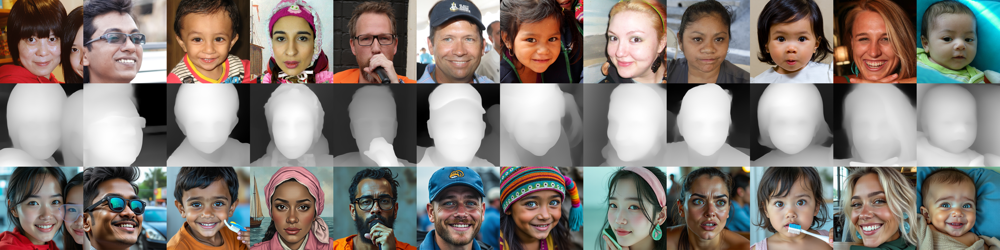

In [22]:
image_grid(img_lst+img_dpth_lst+img_ai_lst, 3,12)

In [23]:
import datetime as dt
end=dt.datetime.now()
print(f'Finished: {end.strftime("%A %B %d, %Y")} at {end.strftime("%H:%M")}')

Finished: Friday August 15, 2025 at 14:09
